# **Zadanie č.2 (I-SUNS)**


## **Príprava dát:**

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sb
import sklearn as sk
from sklearn import preprocessing
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.metrics import make_scorer
from yellowbrick.regressor import ResidualsPlot
import locale as loc
import ast

pd.set_option("display.max_columns", None)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
train_data_df = pd.read_csv('/content/drive/MyDrive/SUNS/datasets/z2_train.csv')
test_data_df = pd.read_csv('/content/drive/MyDrive/SUNS/datasets/z2_test.csv')

---
### **Trénovacie dáta:**

#### **Povodné dáta:**

In [ ]:
train_data_df

,MSSubClass,LotFrontage,LotArea,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Typ,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_Fin,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Ex,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageCond_Ex,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,PavedDrive_N,PavedDrive_P,PavedDrive_Y,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,S

In [ ]:
for column in train_data_df:
  print(column + ' : ' + str(train_data_df[column].isna().sum()) + '/' +  str(train_data_df.shape[0]))

MSSubClass : 0/940
LotFrontage : 0/940
LotArea : 0/940
OverallCond : 0/940
YearBuilt : 0/940
YearRemodAdd : 0/940
MasVnrArea : 0/940
BsmtFinSF1 : 0/940
BsmtFinSF2 : 0/940
BsmtUnfSF : 0/940
TotalBsmtSF : 0/940
1stFlrSF : 0/940
2ndFlrSF : 0/940
LowQualFinSF : 0/940
GrLivArea : 0/940
BsmtFullBath : 0/940
BsmtHalfBath : 0/940
FullBath : 0/940
HalfBath : 0/940
BedroomAbvGr : 0/940
KitchenAbvGr : 0/940
TotRmsAbvGrd : 0/940
Fireplaces : 0/940
GarageYrBlt : 0/940
GarageCars : 0/940
GarageArea : 0/940
WoodDeckSF : 0/940
OpenPorchSF : 0/940
EnclosedPorch : 0/940
3SsnPorch : 0/940
ScreenPorch : 0/940
PoolArea : 0/940
MiscVal : 0/940
MoSold : 0/940
YrSold : 0/940
SalePrice : 0/940
MSZoning_C (all) : 0/940
MSZoning_FV : 0/940
MSZoning_RH : 0/940
MSZoning_RL : 0/940
MSZoning_RM : 0/940
Street_Grvl : 0/940
Street_Pave : 0/940
LotShape_IR1 : 0/940
LotShape_IR2 : 0/940
LotShape_IR3 : 0/940
LotShape_Reg : 0/940
LandContour_Bnk : 0/940
LandContour_HLS : 0/940
LandContour_Low : 0/940
LandContour_Lvl : 0/9

In [ ]:
model = preprocessing.MinMaxScaler().fit(train_data_df.values)

train_data_np_scaled = model.fit_transform(train_data_df.values)

train_data_df = pd.DataFrame(data=train_data_np_scaled, columns=train_data_df.columns)

In [ ]:
train_data_df

,MSSubClass,LotFrontage,LotArea,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Typ,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_Fin,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Ex,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageCond_Ex,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,PavedDrive_N,PavedDrive_P,PavedDrive_Y,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,S

#### **Korelačná matica:**

In [ ]:
tmp = train_data_df[train_data_df.columns[1:]].corr()['SalePrice'][:-1]

In [ ]:
tmp.to_dict()

{'LotFrontage': 0.35888264798513964,
 'LotArea': 0.30505293166877184,
 'OverallCond': -0.13355536501631565,
 'YearBuilt': 0.5118545738333109,
 'YearRemodAdd': 0.5110024590756507,
 'MasVnrArea': 0.4855853009176917,
 'BsmtFinSF1': 0.3849847483635305,
 'BsmtFinSF2': -0.037051635962179114,
 'BsmtUnfSF': 0.18667566579820913,
 'TotalBsmtSF': 0.6162103322217959,
 '1stFlrSF': 0.6142193880684395,
 '2ndFlrSF': 0.3071761980411986,
 'LowQualFinSF': -0.0003142628824492334,
 'GrLivArea': 0.7034533661672657,
 'BsmtFullBath': 0.22415814926102448,
 'BsmtHalfBath': -0.04503637514772511,
 'FullBath': 0.5781425884401268,
 'HalfBath': 0.24480636619641927,
 'BedroomAbvGr': 0.16178764094754405,
 'KitchenAbvGr': -0.10652484853382826,
 'TotRmsAbvGrd': 0.5639954543042103,
 'Fireplaces': 0.4385713602550559,
 'GarageYrBlt': 0.4926173221946734,
 'GarageCars': 0.6581239987087725,
 'GarageArea': 0.6337102430085846,
 'WoodDeckSF': 0.3286429764378444,
 'OpenPorchSF': 0.33807426396347795,
 'EnclosedPorch': -0.148370632

In [ ]:
plt.figure(figsize=(180, 180))
heatmap = sb.heatmap(train_data_df.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

#### **Extrakcia príznaku ceny zo vzoriek:**

In [ ]:
train_target_df = train_data_df[['SalePrice']]
train_data_df = train_data_df.drop('SalePrice', axis=1)

train_target_df

,SalePrice
0,0.138517
1,1.000000
2,0.369172
3,0.110032
4,0.163528
...,...
935,0.076476
936,0.115590
937,0.249676
938,0.341678


---
### **Testovacie dáta:**

In [ ]:
test_data_np_scaled = model.transform(test_data_df.values)

test_data_df = pd.DataFrame(data=test_data_np_scaled, columns=test_data_df.columns)

In [ ]:
test_data_df

,MSSubClass,LotFrontage,LotArea,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice,MSZoning_C (all),MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Grvl,Street_Pave,LotShape_IR1,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_Bnk,LandContour_HLS,LandContour_Low,LandContour_Lvl,LotConfig_Corner,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Gtl,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blmngtn,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Artery,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRNn,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Fin,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Flat,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofMatl_ClyTile,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsbShng,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsbShng,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkCmn,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Ex,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Ex,ExterCond_Fa,ExterCond_Gd,ExterCond_TA,Foundation_BrkTil,Foundation_CBlock,Foundation_PConc,Foundation_Stone,Foundation_Wood,BsmtQual_Ex,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtCond_Fa,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Av,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_ALQ,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_ALQ,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,HeatingQC_Ex,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_N,CentralAir_Y,Electrical_FuseA,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Ex,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj1,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Typ,GarageType_2Types,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_Fin,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Ex,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageCond_Ex,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,PavedDrive_N,PavedDrive_P,PavedDrive_Y,SaleType_COD,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_Abnorml,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,S

In [ ]:
test_target_df = test_data_df[['SalePrice']]
test_data_df = test_data_df.drop('SalePrice', axis=1)

test_target_df

,SalePrice
0,0.151022
1,0.127401
2,0.166307
3,0.116285
4,0.145464
...,...
149,0.103780
150,0.198265
151,0.213549
152,0.145464


## **Rozhodovací strom (DT):**

In [ ]:
dt_model = DecisionTreeRegressor().fit(train_data_df, train_target_df)

In [ ]:
train_pred_df = dt_model.predict(train_data_df)
test_pred_df = dt_model.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.0
R2:  1.0


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.004523242066963722
R2:  0.6060807336771974


In [ ]:
parameters={
    'max_depth' : range(1, 50),
    'max_leaf_nodes' : [None,5,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100],
    }

In [ ]:
reg_decision_model=DecisionTreeRegressor()

grid_model=GridSearchCV(
    estimator=reg_decision_model, 
    param_grid=parameters,
    cv=5,
    verbose=3)

In [ ]:
grid_model.fit(train_data_df, train_target_df)

Výstup streamovania bol skrátený na tento počet posledných riadkov: 5000.
[CV 1/5] END ....max_depth=2, max_leaf_nodes=40;, score=0.547 total time=   0.0s
[CV 2/5] END ....max_depth=2, max_leaf_nodes=40;, score=0.510 total time=   0.0s
[CV 3/5] END ....max_depth=2, max_leaf_nodes=40;, score=0.557 total time=   0.0s
[CV 4/5] END ....max_depth=2, max_leaf_nodes=40;, score=0.595 total time=   0.0s
[CV 5/5] END ....max_depth=2, max_leaf_nodes=40;, score=0.489 total time=   0.0s
[CV 1/5] END ....max_depth=2, max_leaf_nodes=45;, score=0.547 total time=   0.0s
[CV 2/5] END ....max_depth=2, max_leaf_nodes=45;, score=0.510 total time=   0.0s
[CV 3/5] END ....max_depth=2, max_leaf_nodes=45;, score=0.557 total time=   0.0s
[CV 4/5] END ....max_depth=2, max_leaf_nodes=45;, score=0.595 total time=   0.0s
[CV 5/5] END ....max_depth=2, max_leaf_nodes=45;, score=0.489 total time=   0.0s
[CV 1/5] END ....max_depth=2, max_leaf_nodes=50;, score=0.547 total time=   0.0s
[CV 2/5] END ....max_depth=2, max_l

GridSearchCV(cv=5, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': range(1, 50),
                         'max_leaf_nodes': [None, 5, 10, 15, 20, 25, 30, 35, 40,
                                            45, 50, 55, 60, 65, 70, 75, 80, 85,
                                            90, 95, 100]},
             verbose=3)

In [ ]:
grid_model.best_params_

{'max_depth': 41, 'max_leaf_nodes': 55}

In [ ]:
train_pred_df = grid_model.best_estimator_.predict(train_data_df)
test_pred_df = grid_model.best_estimator_.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.0009211940698526832
R2:  0.9324890521442145


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.00376418717333032
R2:  0.672185165492299


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but DecisionTreeRegressor was fitted with feature names
  "X does not have valid feature names, but"


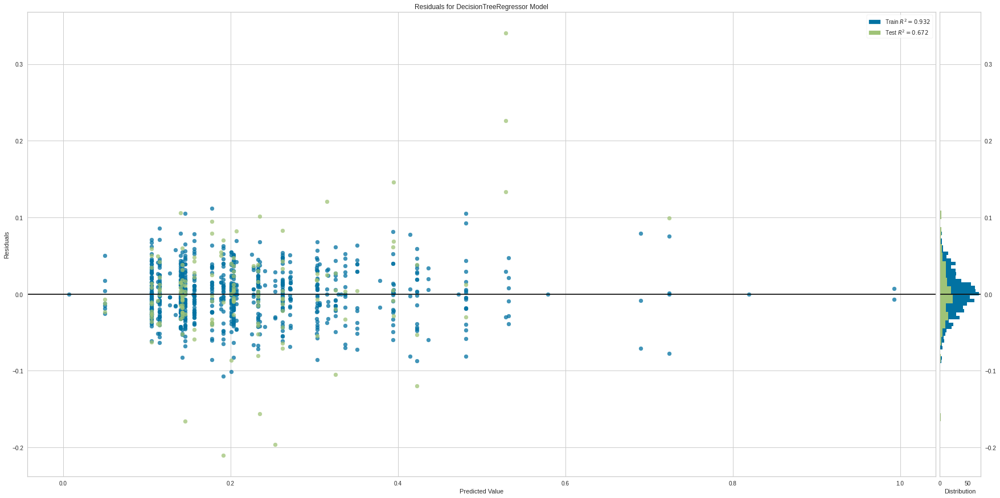

In [ ]:
plt.figure(figsize=(30, 15))
visualizer = ResidualsPlot(grid_model.best_estimator_, hist=True, qqplot=False)
visualizer.fit(train_data_df, train_target_df.values.ravel())
visualizer.score(test_data_df, test_target_df.values.ravel())
visualizer.show()

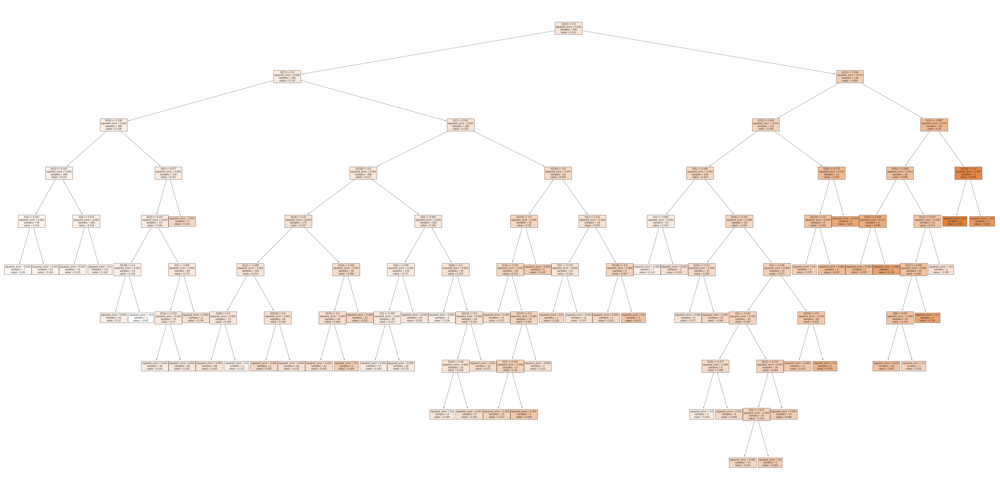

In [ ]:
from sklearn import tree

fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (30, 15), dpi=300)
tree.plot_tree(grid_model.best_estimator_, filled = True)
plt.show()

## **Stroje s podpornými vektormi (SVM):**

In [ ]:
svr_model = SVR(kernel='linear').fit(train_data_df, train_target_df.values.ravel())

In [ ]:
train_pred_df = svr_model.predict(train_data_df)
test_pred_df = svr_model.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.003216320758529767
R2:  0.7642876022298886


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.00453646751321374
R2:  0.6049289584667462


In [ ]:
svr_model = SVR(kernel='rbf').fit(train_data_df, train_target_df.values.ravel())

In [ ]:
train_pred_df = svr_model.predict(train_data_df)
test_pred_df = svr_model.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.002572872337353302
R2:  0.8114435862201879


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.003418357179325228
R2:  0.7023027438783593


In [ ]:
svr_model = SVR(kernel='rbf', gamma='auto').fit(train_data_df, train_target_df.values.ravel())

In [ ]:
train_pred_df = svr_model.predict(train_data_df)
test_pred_df = svr_model.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.003402099220456049
R2:  0.7506725774850603


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.003116931376336312
R2:  0.7285532583116625


In [ ]:
svr_model = SVR(kernel='rbf', gamma='auto', C=0.1).fit(train_data_df, train_target_df.values.ravel())

In [ ]:
train_pred_df = svr_model.predict(train_data_df)
test_pred_df = svr_model.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.005993155564939456
R2:  0.5607835242567919


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.004536880391142249
R2:  0.6048930018302738


In [ ]:
parameters = {
    #'kernel':['linear', 'rbf'],
    #'gamma':['scale'],
    'C':[0.01,0.05,0.1,0.5,1],
    'epsilon':[0.1,0.2,0.5,0.7,1]
    }

In [ ]:
reg_decision_model = SVR()

grid_model = GridSearchCV(
    estimator=reg_decision_model, 
    param_grid=parameters,
    cv=5,
    verbose=3)

In [ ]:
grid_model.fit(train_data_df, train_target_df.values.ravel())

Fitting 5 folds for each of 25 candidates, totalling 125 fits
[CV 1/5] END ...............C=0.01, epsilon=0.1;, score=0.369 total time=   0.0s
[CV 2/5] END ...............C=0.01, epsilon=0.1;, score=0.417 total time=   0.0s
[CV 3/5] END ...............C=0.01, epsilon=0.1;, score=0.381 total time=   0.0s
[CV 4/5] END ...............C=0.01, epsilon=0.1;, score=0.403 total time=   0.0s
[CV 5/5] END ...............C=0.01, epsilon=0.1;, score=0.459 total time=   0.0s
[CV 1/5] END ..............C=0.01, epsilon=0.2;, score=-0.165 total time=   0.0s
[CV 2/5] END ..............C=0.01, epsilon=0.2;, score=-0.418 total time=   0.0s
[CV 3/5] END ..............C=0.01, epsilon=0.2;, score=-0.143 total time=   0.0s
[CV 4/5] END ..............C=0.01, epsilon=0.2;, score=-0.238 total time=   0.0s
[CV 5/5] END ..............C=0.01, epsilon=0.2;, score=-0.226 total time=   0.0s
[CV 1/5] END ..............C=0.01, epsilon=0.5;, score=-5.251 total time=   0.0s
[CV 2/5] END ..............C=0.01, epsilon=0.5;

GridSearchCV(cv=5, estimator=SVR(),
             param_grid={'C': [0.01, 0.05, 0.1, 0.5, 1],
                         'epsilon': [0.1, 0.2, 0.5, 0.7, 1]},
             verbose=3)

In [ ]:
grid_model.best_params_

{'C': 1, 'epsilon': 0.1}

In [ ]:
train_pred_df = grid_model.best_estimator_.predict(train_data_df)
test_pred_df = grid_model.best_estimator_.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.002572872337353302
R2:  0.8114435862201879


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.003418357179325228
R2:  0.7023027438783593


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but SVR was fitted with feature names
  "X does not have valid feature names, but"


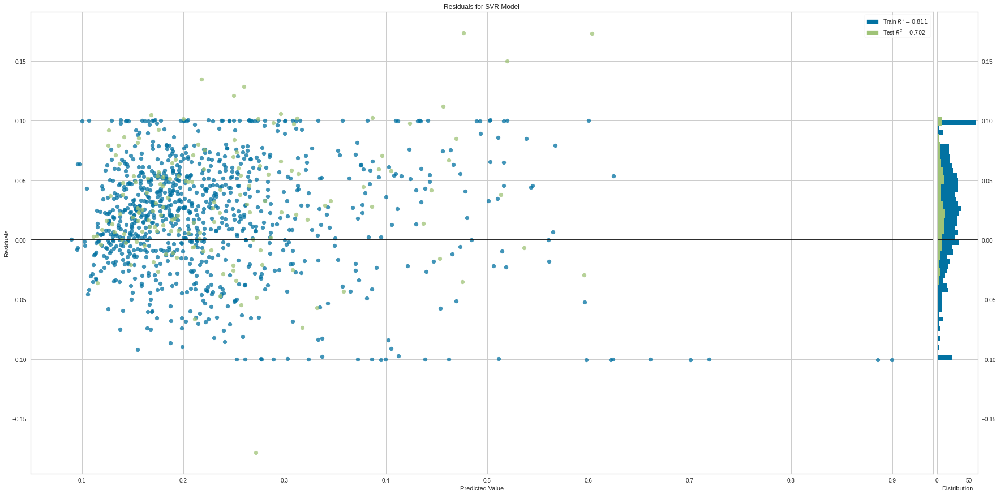

In [ ]:
plt.figure(figsize=(30, 15))
visualizer = ResidualsPlot(grid_model.best_estimator_, hist=True, qqplot=False)
visualizer.fit(train_data_df, train_target_df.values.ravel())
visualizer.score(test_data_df, test_target_df.values.ravel())
visualizer.show()

In [ ]:
#Source: https://qiita.com/bmj0114/items/8009f282c99b77780563
def auc_scorer(target_score, prediction):
    auc_value = roc_auc_score(prediction, target_score)    
    return auc_value

scorer = make_scorer(auc_scorer, greater_is_better=True)

In [ ]:
#Source: https://qiita.com/bmj0114/items/8009f282c99b77780563
scores = grid_model.cv_results_['mean_test_score'].reshape(len([0.01,0.05,0.1,0.5,1]),len([0.1,0.2,0.5,0.7,1]))

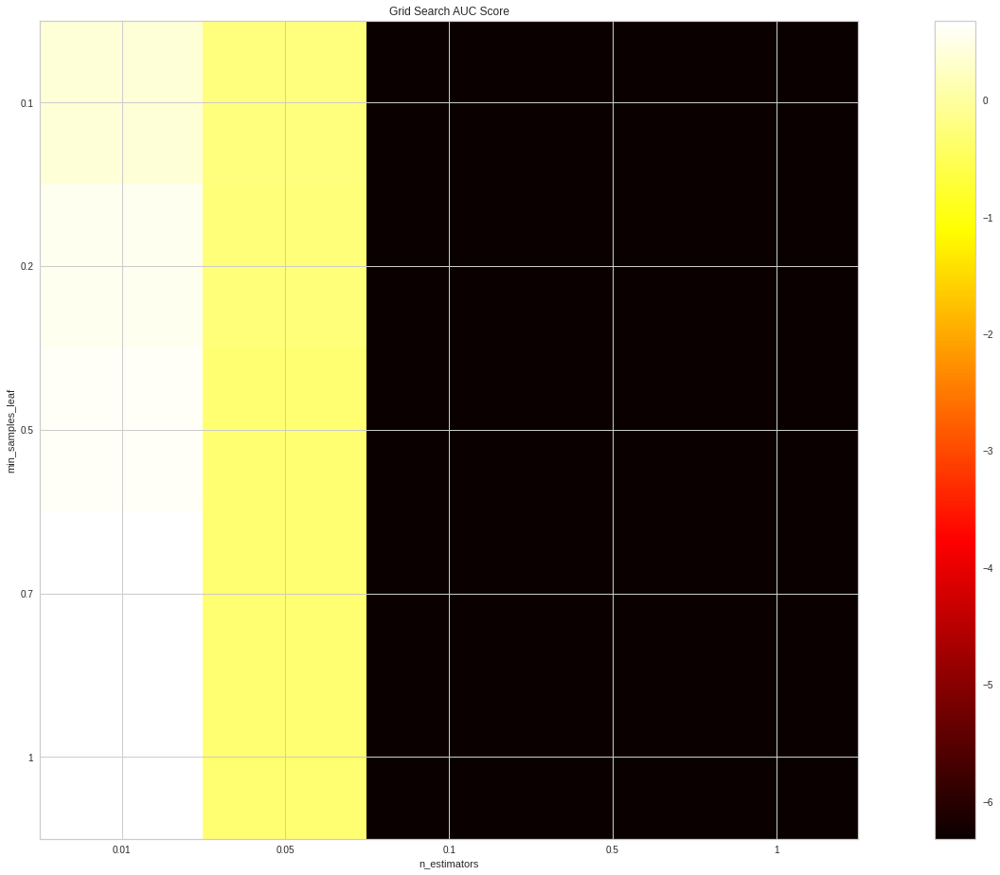

In [ ]:
#Source: https://qiita.com/bmj0114/items/8009f282c99b77780563
plt.figure(figsize=(30, 15))
plt.subplots_adjust(left=.2, right=0.95, bottom=0.15, top=0.95)
plt.imshow(scores, interpolation='nearest', cmap=plt.cm.hot)
plt.xlabel('n_estimators')
plt.ylabel('min_samples_leaf')
plt.colorbar()
plt.xticks(np.arange(len([0.01,0.05,0.1,0.5,1])), [0.01,0.05,0.1,0.5,1])
plt.yticks(np.arange(len([0.1,0.2,0.5,0.7,1])), [0.1,0.2,0.5,0.7,1])
plt.title('Grid Search AUC Score')
plt.show()

## **Náhodný les (RF):**

In [ ]:
rf_model = RandomForestRegressor().fit(train_data_df, train_target_df.values.ravel())

In [ ]:
train_pred_df = rf_model.predict(train_data_df)
test_pred_df = rf_model.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.00027811110675398244
R2:  0.9796182530471723


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.0015741878231402546
R2:  0.8629074227809457


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  "X does not have valid feature names, but"


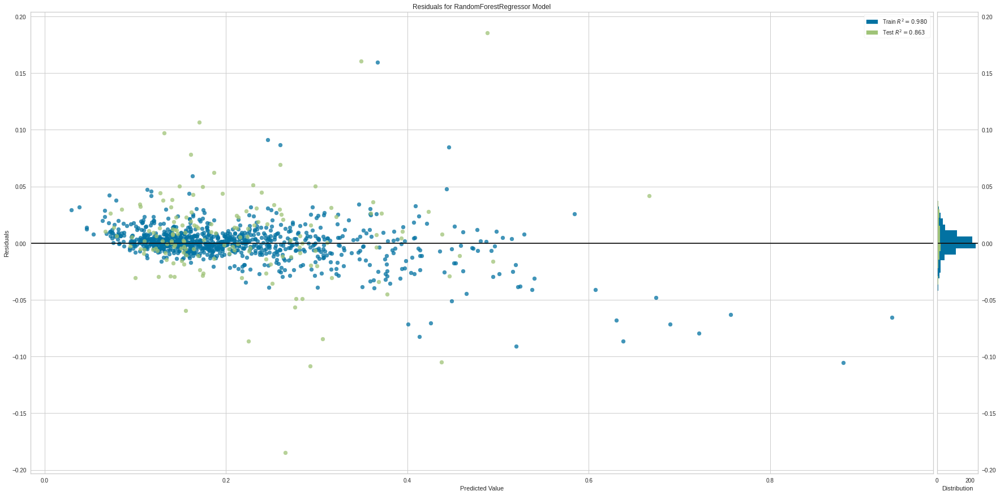

In [ ]:
plt.figure(figsize=(30, 15))
visualizer = ResidualsPlot(rf_model, hist=True, qqplot=False)
visualizer.fit(train_data_df, train_target_df.values.ravel())
visualizer.score(test_data_df, test_target_df.values.ravel())
visualizer.show()

In [ ]:
parameters = {
    'bootstrap': [True],
    'max_depth': [80, 90, 100, 110],
    'max_features': [2, 3],
    'min_samples_leaf': [3, 4, 5],
    'min_samples_split': [8, 10, 12],
    'n_estimators': [10, 100, 1000]
}

In [ ]:
reg_decision_model = RandomForestRegressor()

grid_model = GridSearchCV(
    estimator=reg_decision_model, 
    param_grid=parameters,
    cv=5,
    verbose=3)

In [ ]:
grid_model.fit(train_data_df, train_target_df.values.ravel())

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
[CV 1/5] END bootstrap=True, max_depth=80, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=10;, score=0.441 total time=   0.0s
[CV 2/5] END bootstrap=True, max_depth=80, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=10;, score=0.499 total time=   0.0s
[CV 3/5] END bootstrap=True, max_depth=80, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=10;, score=0.485 total time=   0.0s
[CV 4/5] END bootstrap=True, max_depth=80, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=10;, score=0.572 total time=   0.0s
[CV 5/5] END bootstrap=True, max_depth=80, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=10;, score=0.652 total time=   0.0s
[CV 1/5] END bootstrap=True, max_depth=80, max_features=2, min_samples_leaf=3, min_samples_split=8, n_estimators=100;, score=0.514 total time=   0.2s
[CV 2/5] END bootstrap=True, max_depth=80

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'bootstrap': [True], 'max_depth': [80, 90, 100, 110],
                         'max_features': [2, 3], 'min_samples_leaf': [3, 4, 5],
                         'min_samples_split': [8, 10, 12],
                         'n_estimators': [10, 100, 1000]},
             verbose=3)

In [ ]:
grid_model.best_params_

{'bootstrap': True,
 'max_depth': 110,
 'max_features': 3,
 'min_samples_leaf': 3,
 'min_samples_split': 8,
 'n_estimators': 100}

In [ ]:
train_pred_df = grid_model.best_estimator_.predict(train_data_df)
test_pred_df = grid_model.best_estimator_.predict(test_data_df)

In [ ]:
print("MSE: ", metrics.mean_squared_error(train_target_df, train_pred_df))
print("R2: ", metrics.r2_score(train_target_df, train_pred_df))

MSE:  0.0035316325766642943
R2:  0.7411795510504045


In [ ]:
print("MSE: ", metrics.mean_squared_error(test_target_df, test_pred_df))
print("R2: ", metrics.r2_score(test_target_df, test_pred_df))

MSE:  0.002784430564089579
R2:  0.7575100273885582


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  "X does not have valid feature names, but"


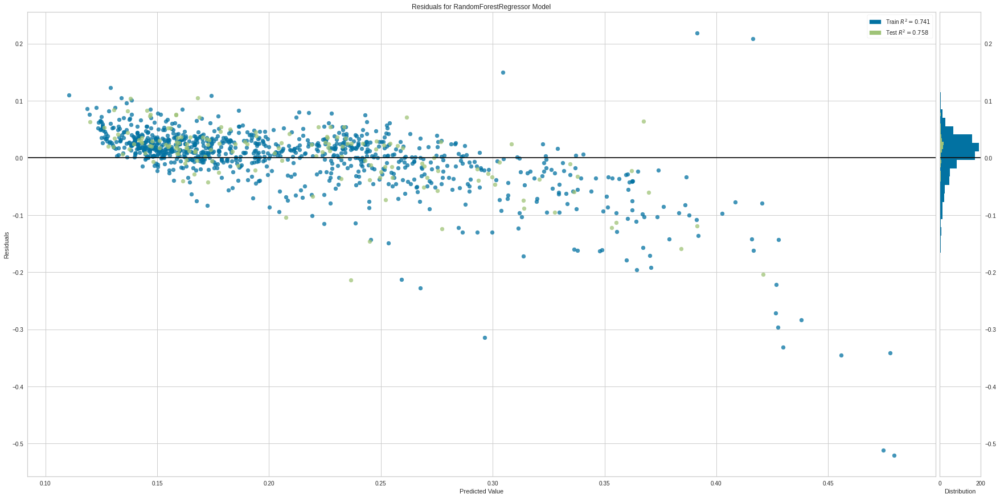

In [ ]:
plt.figure(figsize=(30, 15))
visualizer = ResidualsPlot(grid_model.best_estimator_, hist=True, qqplot=False)
visualizer.fit(train_data_df, train_target_df.values.ravel())
visualizer.score(test_data_df, test_target_df.values.ravel())
visualizer.show()

In [ ]:
pd.DataFrame(grid_model.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_bootstrap,param_max_depth,param_max_features,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.024419,0.004072,0.005165,0.000239,True,80,2,3,8,10,"{'bootstrap': True, 'max_depth': 80, 'max_feat...",0.441326,0.499046,0.485240,0.572034,0.652058,0.529941,0.074148,139
1,0.142094,0.005073,0.015620,0.003594,True,80,2,3,8,100,"{'bootstrap': True, 'max_depth': 80, 'max_feat...",0.513510,0.539705,0.520500,0.559233,0.581949,0.542979,0.025168,134
2,1.355882,0.029799,0.100186,0.005216,True,80,2,3,8,1000,"{'bootstrap': True, 'max_depth': 80, 'max_feat...",0.510371,0.585941,0.500020,0.566399,0.606705,0.553887,0.041879,118
3,0.019838,0.001208,0.005027,0.000125,True,80,2,3,10,10,"{'bootstrap': True, 'max_depth': 80, 'max_feat...",0.362882,0.614765,0.425652,0.535483,0.648805,0.517518,0.108966,143
4,0.139288,0.004897,0.014239,0.002290,True,80,2,3,10,100,"{'bootstrap': True, 'max_depth': 80, 'max_feat...",0.515546,0.579942,0.470481,0.576865,0.609672,0.550501,0.050375,128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
211,0.159025,0.029607,0.013083,0.000307,True,110,3,5,10,100,"{'bootstrap': True, 'max_depth': 110, 'max_fea...",0.565344,0.626599,0.555780,0.611669,0.665545,0.604987,0.040427,66
212,1.368188,0.021920,0.101761,0.009552,True,110,3,5,10,1000,"{'bootstrap': True, 'max_depth': 110, 'max_fea...",0.556432,0.627006,0.553429,0.623681,0.657033,0.603516,0.041348,70
213,0.019962,0.000671,0.005447,0.000400,True,110,3,5,12,10,"{'bootstrap': True, 'max_depth': 110, 'max_fea...",0.537707,0.633796,0.555092,0.582884,0.687466,0.599389,0.054737,78
214,0.151862,0.010910,0.013992,0.000683,True,110,3,5,12,100,"{'bootstrap': True, 'max_depth': 110, 'max_fea...",0.530138,0.625263,0.535798,0.595595,0.658664,0.589092,0.050013,95


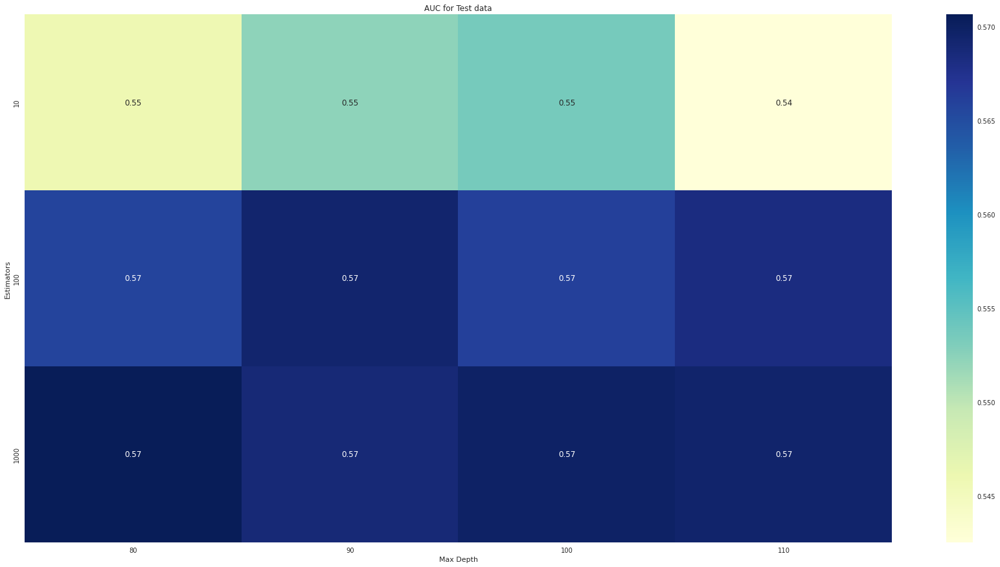

In [ ]:
estimators_list = list(grid_model.cv_results_['param_n_estimators'].data)
max_depth_list = list(grid_model.cv_results_['param_max_depth'].data)

sb.set_style("whitegrid")
plt.figure(figsize=(30, 15))

data = pd.DataFrame(data={'Estimators':estimators_list, 'Max Depth':max_depth_list, 'AUC':grid_model.cv_results_['mean_test_score']})
data = data.pivot_table(index='Estimators', columns='Max Depth', values='AUC', aggfunc='mean')
sb.heatmap(data, annot=True, cmap="YlGnBu").set_title('AUC for Test data')

plt.show()

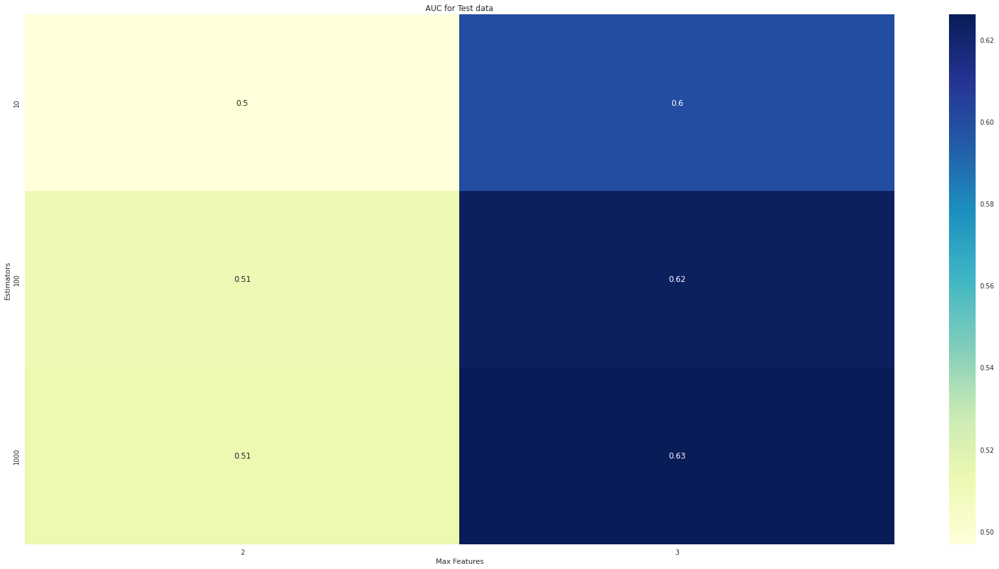

In [ ]:
estimators_list = list(grid_model.cv_results_['param_n_estimators'].data)
max_features_list = list(grid_model.cv_results_['param_max_features'].data)

sb.set_style("whitegrid")
plt.figure(figsize=(30, 15))

data = pd.DataFrame(data={'Estimators':estimators_list, 'Max Features':max_features_list, 'AUC':grid_model.cv_results_['mean_test_score']})
data = data.pivot_table(index='Estimators', columns='Max Features', values='AUC', aggfunc='mean')
sb.heatmap(data, annot=True, cmap="YlGnBu").set_title('AUC for Test data')

plt.show()

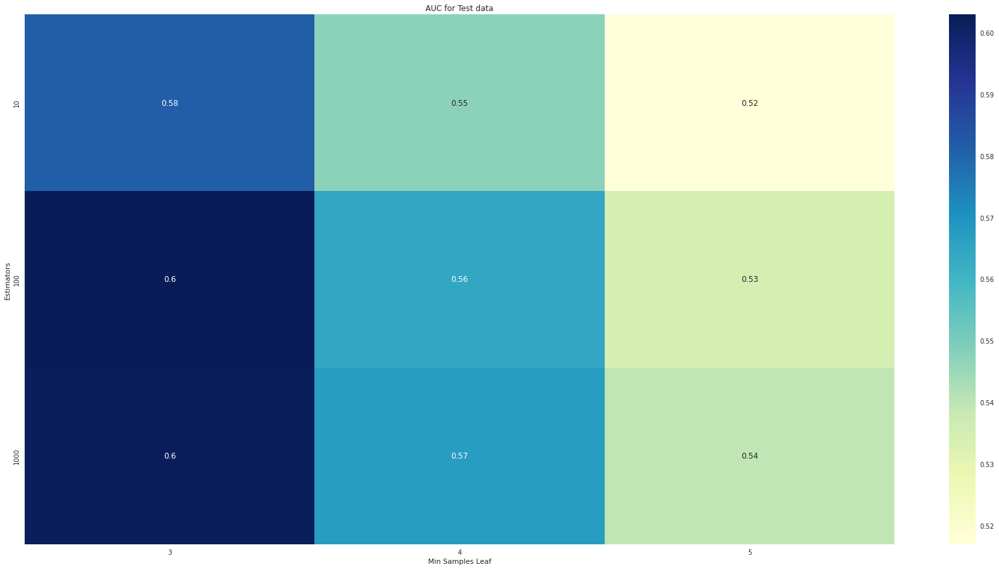

In [ ]:
estimators_list = list(grid_model.cv_results_['param_n_estimators'].data)
min_samples_leaf_list = list(grid_model.cv_results_['param_min_samples_leaf'].data)

sb.set_style("whitegrid")
plt.figure(figsize=(30, 15))

data = pd.DataFrame(data={'Estimators':estimators_list, 'Min Samples Leaf':min_samples_leaf_list, 'AUC':grid_model.cv_results_['mean_test_score']})
data = data.pivot_table(index='Estimators', columns='Min Samples Leaf', values='AUC', aggfunc='mean')
sb.heatmap(data, annot=True, cmap="YlGnBu").set_title('AUC for Test data')

plt.show()

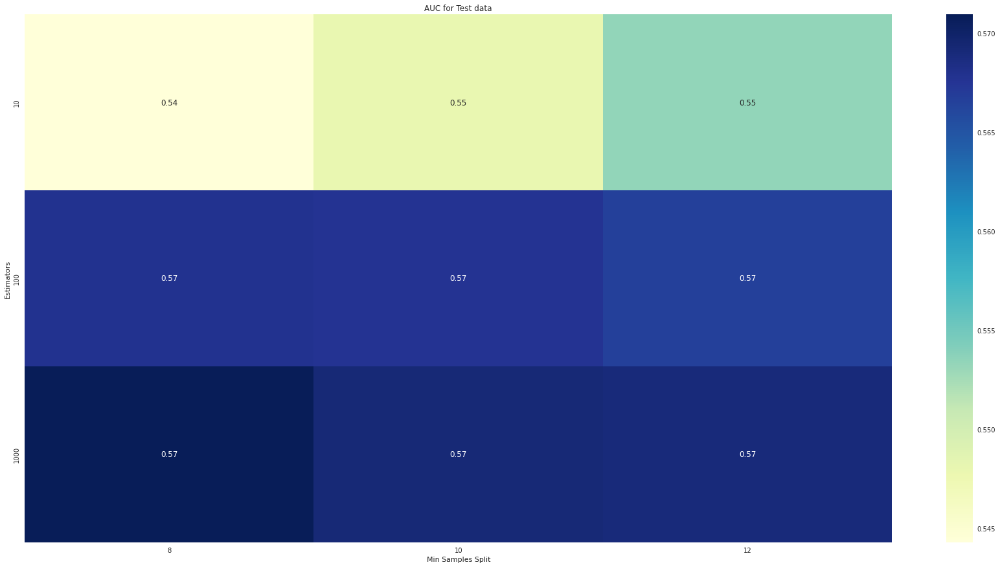

In [ ]:
estimators_list = list(grid_model.cv_results_['param_n_estimators'].data)
min_samples_split_list = list(grid_model.cv_results_['param_min_samples_split'].data)

sb.set_style("whitegrid")
plt.figure(figsize=(30, 15))

data = pd.DataFrame(data={'Estimators':estimators_list, 'Min Samples Split':min_samples_split_list, 'AUC':grid_model.cv_results_['mean_test_score']})
data = data.pivot_table(index='Estimators', columns='Min Samples Split', values='AUC', aggfunc='mean')
sb.heatmap(data, annot=True, cmap="YlGnBu").set_title('AUC for Test data')

plt.show()